In [80]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import calendar

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# libraries required for the geospatial animation plot
from matplotlib.animation import FuncAnimation
import folium
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster

## Loading the Dataset

Let's start by loading the dataset to see what our data looks like.

In [81]:
df = pd.read_csv('data/generated/delhi_stations_hourly.csv')
df.head()

,Datetime,StationId,PM2.5 (ug/m3),PM10 (ug/m3),NO (ug/m3),NO2 (ug/m3),NOx (ug/m3),NH3 (ug/m3),SO2 (ug/m3),CO (ug/m3),...,Benzene (ug/m3),Toluene (ug/m3),RH (%),WS (m/s),WD (degree),BP (mmHg),AT (degree C),RF (mm),SR (W/mt2),AQI
0,2020-11-28 00:00:00,DL004,68.850000,242.810000,18.430000,39.450000,35.730000,63.330000,7.770000,0.440000,...,1.350000,3.180000,73.620000,0.250000,218.980000,NaN,14.740000,0.0,4.380000,NaN
1,2020-11-28 01:00:00,DL004,116.314167,196.385993,21.800417,47.558600,48.732917,38.778182,9.790615,1.106522,...,3.729500,25.674762,68.729524,0.800000,217.970909,981.320556,17.485455,0.0,5.183810,NaN
2,2020-11-28 02:00:00,DL004,118.085745,196.181544,21.502340,49.366855,48.110000,38.363488,10.031594,1.106522,...,3.822368,25.430000,69.821707,0.830976,209.814186,981.070556,17.294884,0.0,5.178049,NaN
3,2020-11-28 03:00:00,DL004,121.146667,195.504038,18.938358,49.432938,44.364478,37.339508,10.039609,1.083125,...,3.757143,23.730169,70.480833,0.900167,210.963016,980.915556,17.177302,0.0,5.129167,NaN
4,2020-11-28 04:00:00,DL004,126.420870,194.864346,15.099394,48.631877,38.598788,36.644667,9.976959,1.011250,...,3.468364,20.480172,71.726667,0.992500,207.958254,980.621111,16.844286,0.0,5.031167,NaN


## Feature Engineering
Feature engineering is like preparing the ingredients for a recipe. In air quality prediction, it means creating special features that help our model make better predictions. We're basically selecting and transforming the data in a way that makes it easier for the model to understand and make accurate predictions about air quality.

### Key Feature Engineering Steps:

1. **Datetime Processing:**
   - Conversion of the 'Datetime' column to a datetime object.
   - Sorting the DataFrame by 'StationId' and 'Datetime' for consistent calculations across stations.
   - Extracting year, month, day of the week, and hour of the day information.

2. **Volatility and Moving Averages:**
   - Calculation of volatilities (standard deviations) for daily, weekly, and monthly rolling windows per station.
   - Computation of moving averages for the last 7 and 30 days.

3. **Next 24-Hour AQI (y_AQI):**
   - Creating a column ('y_AQI') representing the AQI values shifted 24 hours into the future. This serves as the **target variable** for prediction.

### Rationale for Feature Engineering:

- **Temporal Patterns:** Extracting year, month, day of the week, and hour of the day helps the model capture temporal patterns and seasonality in air quality.

- **Volatility and Averages:** Volatility measures and moving averages provide insights into the stability and trends in air quality over different time spans.

- **Prediction Target ('y_AQI'):** The 'y_AQI' column is created to represent the AQI values in the next 24 hours, enabling the model to learn from past data for future predictions.

These engineered features aim to enhance the model's ability to understand and predict air quality dynamics effectively.


In [82]:
# Convert the 'Datetime' column to a pandas datetime object
df['Datetime'] = pd.to_datetime(df['Datetime'])

# Sort the DataFrame by 'StationId' and then 'Datetime' to apply rolling window across stations
df = df.sort_values(by=['StationId', 'Datetime'])

# Reset the index of the DataFrame
df = df.reset_index(drop=True)

# Extract year from the 'Datetime' column
df['Year'] = df['Datetime'].dt.year

# Add a new column 'Month' with month names
# df['Month'] = df['Datetime'].dt.strftime('%B')
df['Month'] = df['Datetime'].dt.month

# Add a new column 'DayOfWeek'
# df['DayOfWeek'] = df['Datetime'].dt.day_name()
df['DayOfWeek'] = df['Datetime'].dt.dayofweek

# Add a new column 'HourOfDay'
df['HourOfDay'] = df['Datetime'].dt.hour

# Calculate volatilities for daily, weekly, and monthly rolling windows per station
df['Volatility_Last_24hr'] = df.groupby('StationId')['AQI'].rolling(window=24).std().reset_index(level=0, drop=True)
df['Volatility_Last_7d'] = df.groupby('StationId')['AQI'].rolling(window=24 * 7).std().reset_index(level=0, drop=True)
df['Volatility_Last_30d'] = df.groupby('StationId')['AQI'].rolling(window=24 * 30).std().reset_index(level=0, drop=True)

# Calculate moving averages for the last 7 and 30 days
df['MA_Last_7d'] = df.groupby('StationId')['AQI'].rolling(window=24 * 7).mean().reset_index(level=0, drop=True)
df['MA_Last_30d'] = df.groupby('StationId')['AQI'].rolling(window=24 * 30).mean().reset_index(level=0, drop=True)

# Next 24 hour AQI (the 'y' variable)
df['y_AQI'] = df['AQI'].shift(periods=-24)
df = df.dropna(subset=['y_AQI'])

df.head()

,Datetime,StationId,PM2.5 (ug/m3),PM10 (ug/m3),NO (ug/m3),NO2 (ug/m3),NOx (ug/m3),NH3 (ug/m3),SO2 (ug/m3),CO (ug/m3),...,Year,Month,DayOfWeek,HourOfDay,Volatility_Last_24hr,Volatility_Last_7d,Volatility_Last_30d,MA_Last_7d,MA_Last_30d,y_AQI
0,2020-11-28 00:00:00,DL004,68.850000,242.810000,18.430000,39.450000,35.730000,63.330000,7.770000,0.440000,...,2020,11,5,0,NaN,NaN,NaN,NaN,NaN,215.0
1,2020-11-28 01:00:00,DL004,116.314167,196.385993,21.800417,47.558600,48.732917,38.778182,9.790615,1.106522,...,2020,11,5,1,NaN,NaN,NaN,NaN,NaN,213.0
2,2020-11-28 02:00:00,DL004,118.085745,196.181544,21.502340,49.366855,48.110000,38.363488,10.031594,1.106522,...,2020,11,5,2,NaN,NaN,NaN,NaN,NaN,212.0
3,2020-11-28 03:00:00,DL004,121.146667,195.504038,18.938358,49.432938,44.364478,37.339508,10.039609,1.083125,...,2020,11,5,3,NaN,NaN,NaN,NaN,NaN,209.0
4,2020-11-28 04:00:00,DL004,126.420870,194.864346,15.099394,48.631877,38.598788,36.644667,9.976959,1.011250,...,2020,11,5,4,NaN,NaN,NaN,NaN,NaN,206.0


## Extracting Lagged Values for Time Series Forecasting

In time series forecasting, the inclusion of lagged values is crucial for capturing temporal patterns, dependencies, and short-term fluctuations in the data. Lagged values represent historical observations of the target variable at different time points.

### Why Extract Lagged Values?

1. **Temporal Dependencies:** Lagged values help the model understand how the current state of the target variable is related to its past states. This is essential for capturing the temporal dependencies inherent in time series data.

2. **Short-Term Patterns:** While moving averages provide a smoothed trend, lagged values allow the model to capture short-term patterns and rapid changes in the data.

3. **Non-Linear Relationships:** Lagged values can reveal non-linear relationships between the target variable and its past values, which may not be adequately represented by moving averages alone.

For the lagged values, we calculate over the "AQI" column. This can provide our time series forecasting model with additional temporal information about the historical patterns of this feature..


In [83]:
# We select the 'y_AQI' column as the feature for which we want to calculate lagged values.
lagged_feature = 'AQI'

# We define the lag periods, which represent the number of time units to shift the observations. In this case, we use lag periods of 24 hours, 48 hours, and 7 days.
# For each lag period, we create new columns with names like 'AQI_lag_24', 'AQI_lag_48', and 'AQI_lag_168' (representing 7 days).
for i in [24, 48, 7 * 24]:
    df[f'{lagged_feature}_lag_{i}'] = df[lagged_feature].shift(i)

# sanity check
df.head()

,Datetime,StationId,PM2.5 (ug/m3),PM10 (ug/m3),NO (ug/m3),NO2 (ug/m3),NOx (ug/m3),NH3 (ug/m3),SO2 (ug/m3),CO (ug/m3),...,HourOfDay,Volatility_Last_24hr,Volatility_Last_7d,Volatility_Last_30d,MA_Last_7d,MA_Last_30d,y_AQI,AQI_lag_24,AQI_lag_48,AQI_lag_168
0,2020-11-28 00:00:00,DL004,68.850000,242.810000,18.430000,39.450000,35.730000,63.330000,7.770000,0.440000,...,0,NaN,NaN,NaN,NaN,NaN,215.0,NaN,NaN,NaN
1,2020-11-28 01:00:00,DL004,116.314167,196.385993,21.800417,47.558600,48.732917,38.778182,9.790615,1.106522,...,1,NaN,NaN,NaN,NaN,NaN,213.0,NaN,NaN,NaN
2,2020-11-28 02:00:00,DL004,118.085745,196.181544,21.502340,49.366855,48.110000,38.363488,10.031594,1.106522,...,2,NaN,NaN,NaN,NaN,NaN,212.0,NaN,NaN,NaN
3,2020-11-28 03:00:00,DL004,121.146667,195.504038,18.938358,49.432938,44.364478,37.339508,10.039609,1.083125,...,3,NaN,NaN,NaN,NaN,NaN,209.0,NaN,NaN,NaN
4,2020-11-28 04:00:00,DL004,126.420870,194.864346,15.099394,48.631877,38.598788,36.644667,9.976959,1.011250,...,4,NaN,NaN,NaN,NaN,NaN,206.0,NaN,NaN,NaN


### AQI Categories Assignment

The code snippet below is dedicated to categorizing Air Quality Index (AQI) values into different predefined categories. The AQI is a numerical scale that represents the level of air pollution and its potential impact on health. The categories provide a qualitative description of the air quality.

#### Steps:

1. **Function Definition:**
   - The `get_AQI_bucket` function is defined, which takes an AQI value (`x`) as input and returns the corresponding category.

2. **Categorization Rules:**
   - The function uses specific ranges to categorize AQI values into different buckets:
      - "Good": AQI <= 50
      - "Satisfactory": 50 < AQI <= 100
      - "Moderate": 100 < AQI <= 200
      - "Poor": 200 < AQI <= 300
      - "Very Poor": 300 < AQI <= 400
      - "Severe": AQI > 400

3. **Application to DataFrame:**
   - The `apply` method is used on the 'AQI' column of the DataFrame (`df`) to assign each AQI value its corresponding category.
   - The results are stored in a new column named 'AQI_Category' in the DataFrame.

#### Purpose:

Assigning AQI categories helps in providing a qualitative assessment of air quality, making it easier to communicate the potential health risks associated with different pollution levels. This categorization is often used for public awareness and regulatory purposes.

In [84]:
## AQI Categories
def get_AQI_bucket(x):
    if x <= 50:
        return "Good"
    elif x <= 100:
        return "Satisfactory"
    elif x <= 200:
        return "Moderate"
    elif x <= 300:
        return "Poor"
    elif x <= 400:
        return "Very Poor"
    elif x > 400:
        return "Severe"
    else:
        return np.NaN

df["AQI_Category"] = df["AQI"].apply(lambda x: get_AQI_bucket(x))

# display the first few rows of the DataFrame, showing the original AQI values along with their assigned categories.
df.head()

,Datetime,StationId,PM2.5 (ug/m3),PM10 (ug/m3),NO (ug/m3),NO2 (ug/m3),NOx (ug/m3),NH3 (ug/m3),SO2 (ug/m3),CO (ug/m3),...,Volatility_Last_24hr,Volatility_Last_7d,Volatility_Last_30d,MA_Last_7d,MA_Last_30d,y_AQI,AQI_lag_24,AQI_lag_48,AQI_lag_168,AQI_Category
0,2020-11-28 00:00:00,DL004,68.850000,242.810000,18.430000,39.450000,35.730000,63.330000,7.770000,0.440000,...,NaN,NaN,NaN,NaN,NaN,215.0,NaN,NaN,NaN,NaN
1,2020-11-28 01:00:00,DL004,116.314167,196.385993,21.800417,47.558600,48.732917,38.778182,9.790615,1.106522,...,NaN,NaN,NaN,NaN,NaN,213.0,NaN,NaN,NaN,NaN
2,2020-11-28 02:00:00,DL004,118.085745,196.181544,21.502340,49.366855,48.110000,38.363488,10.031594,1.106522,...,NaN,NaN,NaN,NaN,NaN,212.0,NaN,NaN,NaN,NaN
3,2020-11-28 03:00:00,DL004,121.146667,195.504038,18.938358,49.432938,44.364478,37.339508,10.039609,1.083125,...,NaN,NaN,NaN,NaN,NaN,209.0,NaN,NaN,NaN,NaN
4,2020-11-28 04:00:00,DL004,126.420870,194.864346,15.099394,48.631877,38.598788,36.644667,9.976959,1.011250,...,NaN,NaN,NaN,NaN,NaN,206.0,NaN,NaN,NaN,NaN


## Data Filtering and Sorting

Here, we filter the records to keep data only from January 1, 2021, onward, to focus on post-pandemic air quality trends. Additionally, we sort the DataFrame based on 'Datetime' and 'StationId' to prepare the data for applying rolling windows across stations.

### Reason for Including Data from November 2020 at the beginning:
While calculating volatility, moving averages, and lagged values, it's essential to keep a buffer period to avoid null values at the beginning of the dataset. By including data from November 2020, we ensure that these calculations have sufficient historical data, minimizing the need to handle null values later in the analysis.

### Reason for Limiting Data Post-2021:
Considering the impact of the pandemic on air quality, restricting the analysis to data from 2021 onward allows for a more accurate understanding of the overall air pollution trend in Delhi. During lockdowns, people predominantly stayed home, influencing air quality readings and potentially skewing the data. Therefore, focusing on post-pandemic data provides a clearer representation of the usual air pollution patterns.

In [85]:
# Filter records before "2021-01-01"
df = df[df['Datetime'] >= "2021-01-01"]

# Sort the DataFrame by 'Datetime' to apply rolling window across stations
df = df.sort_values(by=['Datetime', 'StationId'])

# Reset the index of the DataFrame
df = df.reset_index(drop=True)

df.head()

,Datetime,StationId,PM2.5 (ug/m3),PM10 (ug/m3),NO (ug/m3),NO2 (ug/m3),NOx (ug/m3),NH3 (ug/m3),SO2 (ug/m3),CO (ug/m3),...,Volatility_Last_24hr,Volatility_Last_7d,Volatility_Last_30d,MA_Last_7d,MA_Last_30d,y_AQI,AQI_lag_24,AQI_lag_48,AQI_lag_168,AQI_Category
0,2021-01-01,DL004,363.873333,327.733876,137.860580,49.843756,153.558696,60.277424,9.421631,3.591000,...,17.256326,48.130540,97.872474,277.660714,299.656944,444.0,214.0,268.0,451.0,Poor
1,2021-01-01,DL007,363.873333,328.043690,137.860580,49.864090,153.558696,60.277424,9.425902,3.591000,...,13.934370,48.578413,66.307935,350.577381,359.443056,517.0,333.0,312.0,448.0,Very Poor
2,2021-01-01,DL011,365.559583,328.357307,138.026667,49.884244,153.490870,60.277424,9.430173,3.601857,...,6.173224,55.296431,71.839095,298.702381,296.847222,471.0,314.0,248.0,390.0,Very Poor
3,2021-01-01,DL014,366.236667,328.671352,138.017681,49.904217,153.309710,60.332273,9.434156,3.607571,...,28.097366,56.985763,78.837344,346.255952,364.241667,680.0,326.0,306.0,457.0,Severe
4,2021-01-01,DL016,367.736389,328.989126,141.738261,49.925545,150.962941,60.332273,9.438139,3.636143,...,7.459553,60.041259,98.204325,318.369048,326.927778,448.0,322.0,264.0,445.0,Very Poor


In [86]:
# display dimensions of data:
print(f'data includes {df.shape[0]} rows and {df.shape[1]} columns.')

data includes 491616 rows and 35 columns.


#### Checking for Duplicate Rows in the Dataset

In [87]:
# check the exact duplicates rows:## Checking for Duplicate Rows in the Dataset

df.duplicated().sum()

0

#### Counting the Frequency of AQI Categories

In [34]:
df.AQI_Category.value_counts()

AQI_Category
Moderate        155663
Very Poor       131646
Poor             83679
Satisfactory     71348
Severe           38263
Good             11017
Name: count, dtype: int64

I collected latitude and longitude values for each of the 25 stations in Delhi and stored them in a separate CSV file. By loading this information into the main DataFrame, I enrich the dataset with geographical coordinates, which can be valuable for spatial analysis and visualization.

In [35]:
# Loading the Latitude and Longitude data for the 25 Delhi stations
delhi_stations_lat_lon = pd.read_csv('data/delhi_stations_info.csv')
delhi_stations_lat_lon.head()

,file_name,state,city,agency,station_location,start_month,start_month_num,start_year,latitude,longitude
0,DL001,Delhi,Delhi,CPCB,"ITO, Delhi",January,1,2010,28.628624,77.241060
1,DL002,Delhi,Delhi,CPCB,"Shadipur, Delhi",January,1,2010,28.651478,77.147311
2,DL003,Delhi,Delhi,CPCB,"Sirifort, Delhi",January,1,2010,28.550425,77.215938
3,DL004,Delhi,Delhi,CPCB,"NSIT Dwarka, Delhi",January,1,2010,28.609090,77.032541
4,DL005,Delhi,Delhi,CPCB,"IHBAS, Dilshad Garden, Delhi",January,1,2010,28.681174,77.302523


Merging the latitude and logitude dataframe with our original dataframe

In [36]:
# Selecting only the relevant columns from delhi_stations_lat_lon
selected_columns = ['file_name', 'latitude', 'longitude']
stations_lat_lon_subset = delhi_stations_lat_lon[selected_columns]

# Merge the dataframes based on 'file_name' in "delhi_stations_lat_lon" dataframe and 'StationId' in our original dataframe "df"
df = pd.merge(df, stations_lat_lon_subset, left_on='StationId', right_on='file_name', how='left')

# Drop the redundant 'file_name' column if needed
df = df.drop('file_name', axis=1)

# Display the first few rows of the merged dataframe
df.head()

,Datetime,StationId,PM2.5 (ug/m3),PM10 (ug/m3),NO (ug/m3),NO2 (ug/m3),NOx (ug/m3),NH3 (ug/m3),SO2 (ug/m3),CO (ug/m3),...,HourOfDay,Volatility_Last_24hr,Volatility_Last_7d,Volatility_Last_30d,MA_Last_7d,MA_Last_30d,y_AQI,AQI_Category,latitude,longitude
0,2021-01-01,DL004,363.873333,327.733876,137.860580,49.843756,153.558696,60.277424,9.421631,3.591000,...,0,17.256326,48.130540,97.872474,277.660714,299.656944,444.0,Poor,28.609090,77.032541
1,2021-01-01,DL007,363.873333,328.043690,137.860580,49.864090,153.558696,60.277424,9.425902,3.591000,...,0,13.934370,48.578413,66.307935,350.577381,359.443056,517.0,Very Poor,28.725650,77.201157
2,2021-01-01,DL011,365.559583,328.357307,138.026667,49.884244,153.490870,60.277424,9.430173,3.601857,...,0,6.173224,55.296431,71.839095,298.702381,296.847222,471.0,Very Poor,28.470691,77.109936
3,2021-01-01,DL014,366.236667,328.671352,138.017681,49.904217,153.309710,60.332273,9.434156,3.607571,...,0,28.097366,56.985763,78.837344,346.255952,364.241667,680.0,Severe,28.674045,77.131023
4,2021-01-01,DL016,367.736389,328.989126,141.738261,49.925545,150.962941,60.332273,9.438139,3.636143,...,0,7.459553,60.041259,98.204325,318.369048,326.927778,448.0,Very Poor,28.562776,77.118005


In [37]:
df.columns

Index(['Datetime', 'StationId', 'PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)',
       'NO2 (ug/m3)', 'NOx (ug/m3)', 'NH3 (ug/m3)', 'SO2 (ug/m3)',
       'CO (ug/m3)', 'Ozone (ug/m3)', 'Benzene (ug/m3)', 'Toluene (ug/m3)',
       'RH (%)', 'WS (m/s)', 'WD (degree)', 'BP (mmHg)', 'AT (degree C)',
       'RF (mm)', 'SR (W/mt2)', 'AQI', 'Year', 'Month', 'DayOfWeek',
       'HourOfDay', 'Volatility_Last_24hr', 'Volatility_Last_7d',
       'Volatility_Last_30d', 'MA_Last_7d', 'MA_Last_30d', 'y_AQI',
       'AQI_Category', 'latitude', 'longitude'],
      dtype='object')

In [38]:
# Descriptive Statistics
# Display summary statistics
df.describe().T

,count,mean,min,25%,50%,75%,max,std
Datetime,491616,2022-02-14 15:49:36.010545408,2021-01-01 00:00:00,2021-07-24 20:00:00,2022-02-14 16:00:00,2022-09-07 12:00:00,2023-03-31 23:00:00,NaN
PM2.5 (ug/m3),491616.0,105.980478,3.764318,43.561231,79.271555,147.148379,703.8195,83.757875
PM10 (ug/m3),491616.0,216.859947,15.088403,123.209423,211.423777,295.728695,618.229243,111.273465
NO (ug/m3),491616.0,32.487898,2.258095,8.025147,14.724198,35.95254,258.809474,41.847288
NO2 (ug/m3),491616.0,37.253236,8.998439,24.825572,35.578124,46.984038,87.575804,14.42571
NOx (ug/m3),491616.0,51.886831,5.803966,22.36309,34.875036,63.053798,258.574655,44.456457
NH3 (ug/m3),491616.0,44.423631,19.516885,36.1715,43.004545,51.304799,102.629333,11.381457
SO2 (ug/m3),491616.0,10.401776,4.445487,7.348525,8.91042,11.788194,30.362324,4.463588
CO (ug/m3),491616.0,1.267806,0.38875,0.872917,1.078968,1.455217,4.358906,0.590645
Ozone (ug/m3),491616.0,29.241333,3.466923,11.784858,20.300436,40.357424,123.361395,23.328119


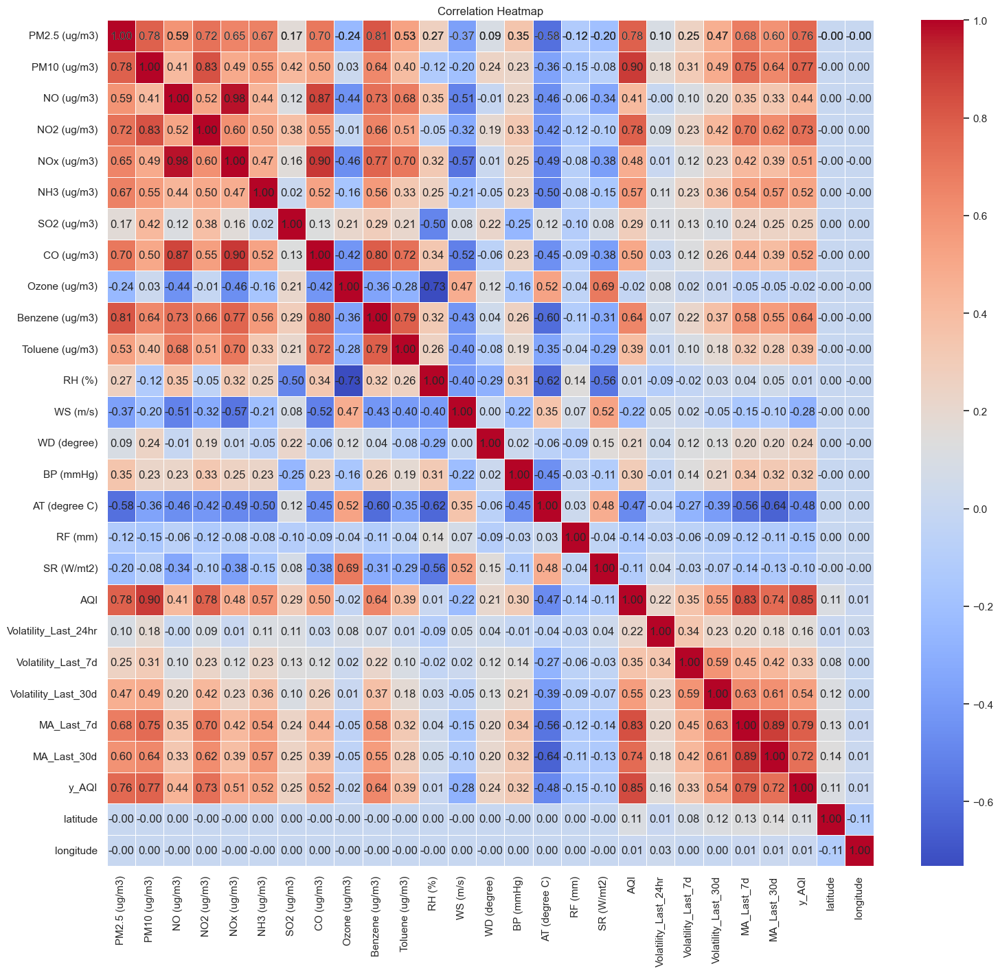

In [39]:
# Extract relevant columns for correlation heatmap
correlation_columns = ['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)', 'NOx (ug/m3)', 'NH3 (ug/m3)', 'SO2 (ug/m3)', 'CO (ug/m3)', 'Ozone (ug/m3)', 'Benzene (ug/m3)', 'Toluene (ug/m3)', 'RH (%)', 'WS (m/s)', 'WD (degree)', 'BP (mmHg)', 'AT (degree C)', 'RF (mm)','SR (W/mt2)', 'AQI', 'Volatility_Last_24hr', 'Volatility_Last_7d',
       'Volatility_Last_30d', 'MA_Last_7d', 'MA_Last_30d', 'y_AQI', 'latitude', 'longitude']

# Calculate the correlation matrix
correlation_matrix = df[correlation_columns].corr()

# Set up the matplotlib figure
plt.figure(figsize=(18, 16))

# Create a heatmap
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, fmt='.2f', linewidths=.5)

# Manually annotate the values
for i in range(len(correlation_matrix)):
    for j in range(len(correlation_matrix.columns)):
        plt.text(j + 0.5, i + 0.5, f"{correlation_matrix.iloc[i, j]:.2f}", ha='center', va='center')

# Set title
plt.title('Correlation Heatmap')

# Show the plot
plt.show()

#### Findings:

* As expected, the columns 'PM2.5' and 'PM10' particles exhibit a strong positive correlation since both of these originate from similar sources, these are just different sizes of particulate matters.

* 'MA_Last7D' and 'MA_Last30D' show a high positive correlation with each other. This is because these are calculated from the same source(Date).

* Similarly the columns 'Volatility_Last7D' and 'Volatility_Last30D' are positively correlated since these are the calculated moving averages accross 7 days and 30 days respectively.
'Benzene' and 'Toluene' also have a high correlation of 0.54, we can keep that in mind.

* NO, NO2, and NOx are strongly positively correlated due to common emission sources, chemical reactions in the atmosphere (NO as a precursor to NO2), and their collective representation in the term NOx.

* 'MA_Last7D' and 'MA_Last30D' are highly correlated with 'AQI' column since they are both derived from the 'AQI' column.

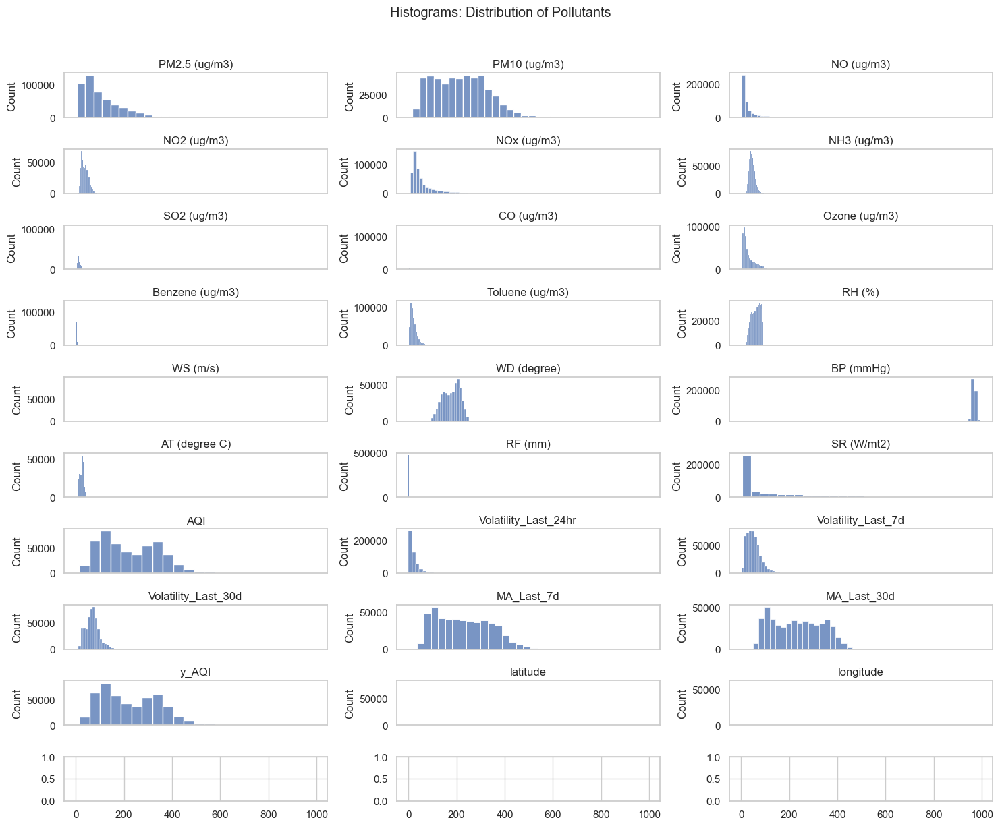

In [40]:
# # Histograms: Distribution of pollutants
pollutants = ['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)', 'NOx (ug/m3)', 'NH3 (ug/m3)', 'SO2 (ug/m3)', 'CO (ug/m3)', 'Ozone (ug/m3)', 'Benzene (ug/m3)', 'Toluene (ug/m3)', 'RH (%)', 'WS (m/s)', 'WD (degree)', 'BP (mmHg)', 'AT (degree C)', 'RF (mm)','SR (W/mt2)', 'AQI', 'Volatility_Last_24hr', 'Volatility_Last_7d',
       'Volatility_Last_30d', 'MA_Last_7d', 'MA_Last_30d', 'y_AQI', 'latitude', 'longitude']
fig, axes = plt.subplots(nrows=10, ncols=3, figsize=(15, 12), sharex=True)  # Use sharex to link x-axis across subplots
fig.suptitle('Histograms: Distribution of Pollutants', y=1.02)

for i, pollutant in enumerate(pollutants):
    row, col = divmod(i, 3)
    ax = axes[row, col]
    sns.histplot(df[pollutant], bins=20, kde=False, ax=ax)
    ax.set_title(pollutant)
    
    # Rotate x-axis labels
    ax.tick_params(axis='x', rotation=45)
    
    # Remove grid lines
    ax.grid(False)

plt.tight_layout()  # Automatically adjusts subplot parameters to avoid overlapping
plt.show()

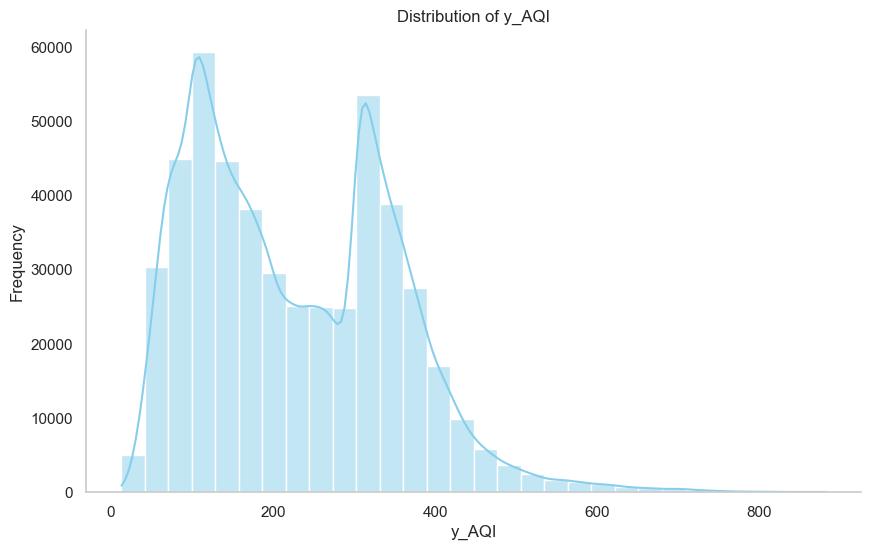

In [52]:
# Set the style for the plot
sns.set(style="whitegrid")

# Create a histogram for the 'AQI' column
plt.figure(figsize=(10, 6))
sns.histplot(df['y_AQI'], bins=30, kde=True, color='skyblue')

# Add labels and title
plt.title('Distribution of y_AQI')
plt.xlabel('y_AQI')
plt.ylabel('Frequency')

# Remove top right frame
sns.despine(top=True, right=True)

# Remove grid lines
plt.grid(False)

# Display the plot
plt.show()

Geospatial animation

In [42]:
# Function to update the map with y_AQI values on each date
def update_map(date):
    # Create a folium map for each frame
    m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=10)

    # Create a MarkerCluster layer for each frame
    marker_cluster = MarkerCluster().add_to(m)
    
    # Filter data for the specific date
    filtered_data = df[df['Datetime'] == date]
    
    # Add markers to the MarkerCluster layer
    for index, row in filtered_data.iterrows():
        folium.Marker([row['latitude'], row['longitude']], 
                      popup=f'y_AQI: {row["y_AQI"]}', 
                      icon=None).add_to(marker_cluster)

    # Display the map for each frame
    display(m)

# Get unique dates for animation frames
animation_dates = df['Datetime'].unique()

# Create an animation and assign it to a variable
ani = FuncAnimation(plt.gcf(), update_map, frames=animation_dates, repeat=False)

# Display the animation
display(plt.gcf())

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [44]:
chart_df = df.copy()

# Create 'Year_Month' column with the 1st day of every month
chart_df['YearMonth'] = chart_df['Datetime'].dt.to_period('M').dt.to_timestamp()

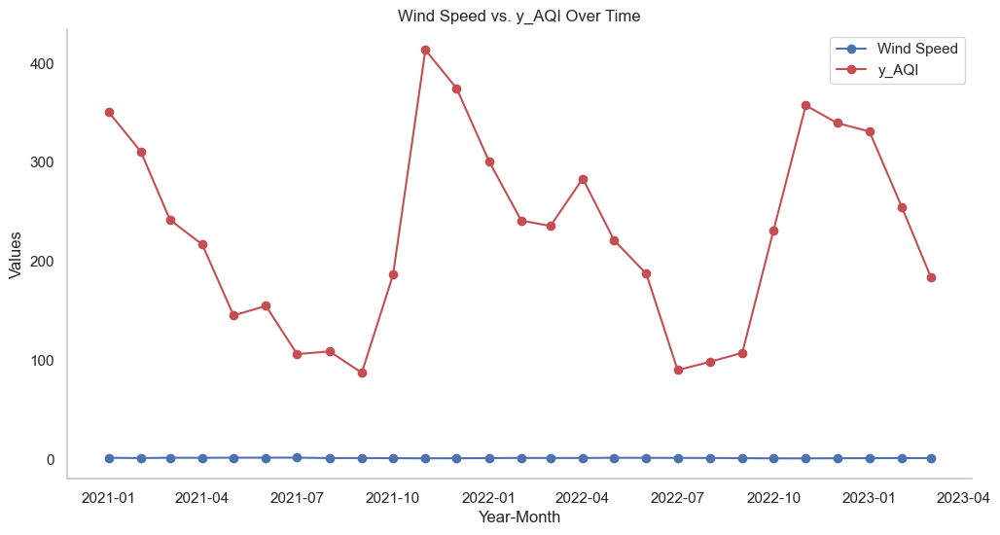

In [51]:
# Weather Impact
# Convert 'YearMonth' to datetime format
chart_df['YearMonth'] = pd.to_datetime(chart_df['YearMonth'])

# Group by 'YearMonth' and calculate mean Wind Speed and y_AQI
wind_speed_aqi_mean = chart_df.groupby('YearMonth')[['WS (m/s)', 'y_AQI']].mean().reset_index()

# Create a line chart for the relationship between Wind Speed and y_AQI
plt.figure(figsize=(12, 6))
plt.plot(wind_speed_aqi_mean['YearMonth'], wind_speed_aqi_mean['WS (m/s)'], marker='o', linestyle='-', color='b', label='Wind Speed')
plt.plot(wind_speed_aqi_mean['YearMonth'], wind_speed_aqi_mean['y_AQI'], marker='o', linestyle='-', color='r', label='y_AQI')

# Customize the plot
plt.title('Wind Speed vs. y_AQI Over Time')
plt.xlabel('Year-Month')
plt.ylabel('Values')
plt.legend()
plt.grid(True)

# Remove top right frame
sns.despine(top=True, right=True)

# Remove grid lines
plt.grid(False)

plt.show()


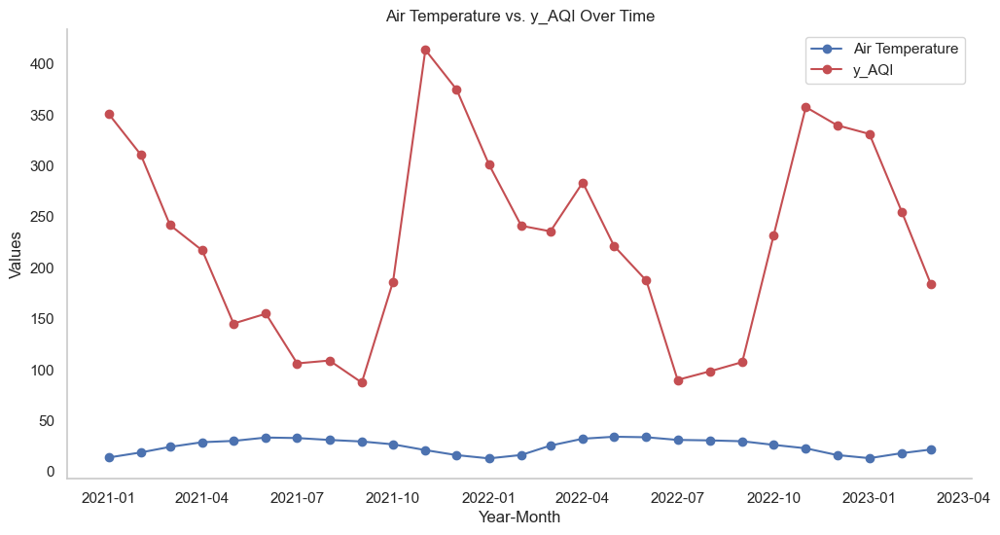

In [50]:
# Convert 'YearMonth' to datetime format
chart_df['YearMonth'] = pd.to_datetime(chart_df['YearMonth'])

# Group by 'YearMonth' and calculate mean Air Temperature and y_AQI
temperature_aqi_mean = chart_df.groupby('YearMonth')[['AT (degree C)', 'y_AQI']].mean().reset_index()

# Create a line chart for the relationship between Air Temperature and y_AQI
plt.figure(figsize=(12, 6))
plt.plot(temperature_aqi_mean['YearMonth'], temperature_aqi_mean['AT (degree C)'], marker='o', linestyle='-', color='b', label='Air Temperature')
plt.plot(temperature_aqi_mean['YearMonth'], temperature_aqi_mean['y_AQI'], marker='o', linestyle='-', color='r', label='y_AQI')

# Customize the plot
plt.title('Air Temperature vs. y_AQI Over Time')
plt.xlabel('Year-Month')
plt.ylabel('Values')
plt.legend()
plt.grid(True)

# Remove top right frame
sns.despine(top=True, right=True)

# Remove grid lines
plt.grid(False)

plt.show()

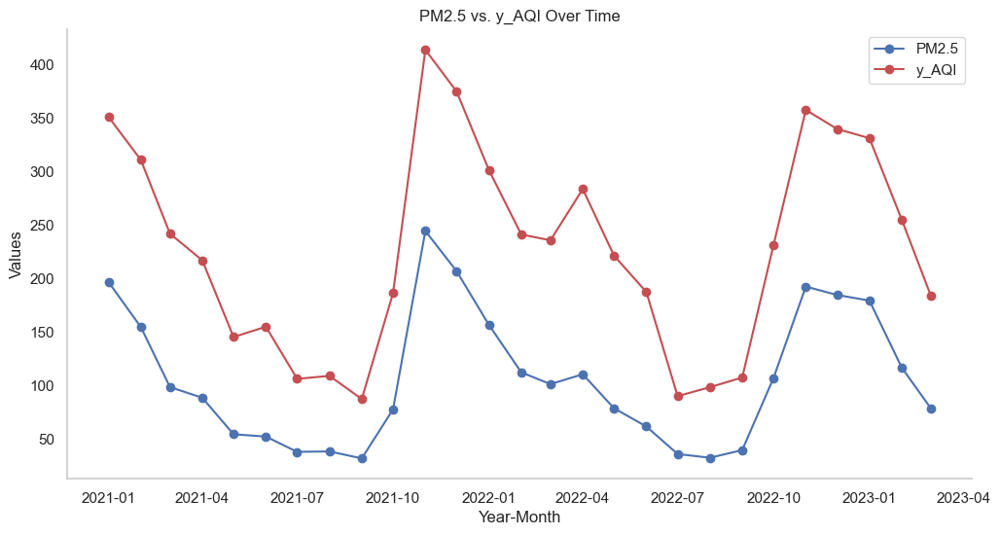

In [49]:
# Convert 'YearMonth' to datetime format
chart_df['YearMonth'] = pd.to_datetime(chart_df['YearMonth'])

# Group by 'YearMonth' and calculate mean PM2.5 and y_AQI
pm25_aqi_mean = chart_df.groupby('YearMonth')[['PM2.5 (ug/m3)', 'y_AQI']].mean().reset_index()

# Create a line chart for the relationship between PM2.5 and y_AQI
plt.figure(figsize=(12, 6))
plt.plot(pm25_aqi_mean['YearMonth'], pm25_aqi_mean['PM2.5 (ug/m3)'], marker='o', linestyle='-', color='b', label='PM2.5')
plt.plot(pm25_aqi_mean['YearMonth'], pm25_aqi_mean['y_AQI'], marker='o', linestyle='-', color='r', label='y_AQI')

# Customize the plot
plt.title('PM2.5 vs. y_AQI Over Time')
plt.xlabel('Year-Month')
plt.ylabel('Values')
plt.legend()
plt.grid(True)

# Remove top right frame
sns.despine(top=True, right=True)

# Remove grid lines
plt.grid(False)

plt.show()

### Hypothesis Test: Correlation between 'PM2.5 (ug/m3)' and 'y_AQI'

Let's investigate if there's a significant linear correlation between 'PM2.5 (ug/m3)' and 'y_AQI'.

**Hypotheses:**
- **H0:** There is no significant correlation between the two variables.
- **H1:** There is a significant correlation between the two.

**Statistical Test:** Pearson Correlation Test

**Decision Rule:**
- If p-value < 0.05, reject Null Hypothesis(H0).
- If p-value ≥ 0.05, fail to reject H0.

In [ ]:
import scipy.stats as stats

# Extract the relevant columns
feature = chart_df['PM2.5 (ug/m3)']
target = chart_df['y_AQI']

# Perform the Pearson correlation test
# Using scipy.stats.pearsonr to compute the correlation coefficient and p-value.
correlation_coefficient, p_value = stats.pearsonr(feature, target)

print(f"Correlation Coefficient: {correlation_coefficient:.4f}")
print(f"P-value: {p_value:.4e}")

(0.7561161882326791, 0.0)

**Results:**
- **Correlation Coefficient:** 0.76
- **P-value:** 0.0

**Conclusion:**
- We can see that a significantly small p-value(0.0) which is less than 0.05, we can safely reject the null hypothesis, i.e, there is a significant correlation.
- A correlation coefficient of 0.76 indicates a strong positive correlation. This means that as the 'PM2.5 (ug/m3)' values increase, the 'y_AQI' values tend to increase as well.
- With a p-value of 0.0, the result is statistically significant. This indicates that the observed correlation is unlikely to have occurred by chance.

### Visualization: Scatter Plot with Regression Line for 'PM2.5 (ug/m3)' vs. 'y_AQI'

**Objective:** Visualize the linear correlation between 'PM2.5 (ug/m3)' and 'y_AQI'

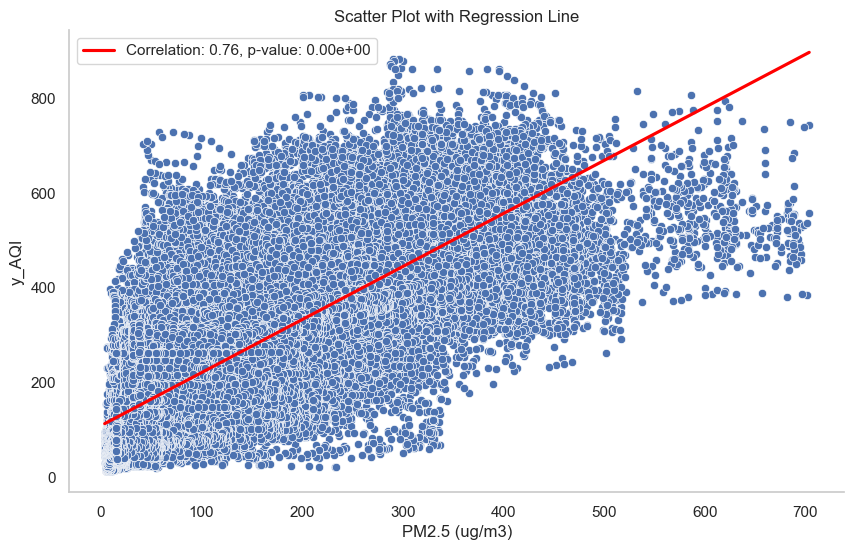

In [58]:
# Plotting
plt.figure(figsize=(10, 6))

# Scatter plot of 'PM2.5 (ug/m3)' against 'y_AQI'
sns.scatterplot(x='PM2.5 (ug/m3)', y='y_AQI', data=chart_df)

# overlay a Regression Line on the scatter plot
sns.regplot(x='PM2.5 (ug/m3)', y='y_AQI', data=chart_df, scatter=False, color='red', label=f'Correlation: {correlation_coefficient:.2f}, p-value: {p_value:.2e}')

# Customize the plot
# Set plot title, x-axis label, y-axis label, legend, and grid
plt.title('Scatter Plot with Regression Line')
plt.xlabel('PM2.5 (ug/m3)')
plt.ylabel('y_AQI')
plt.legend()
plt.grid(True)

# Remove top right frame
sns.despine(top=True, right=True)

# Remove grid lines
plt.grid(False)

plt.show()

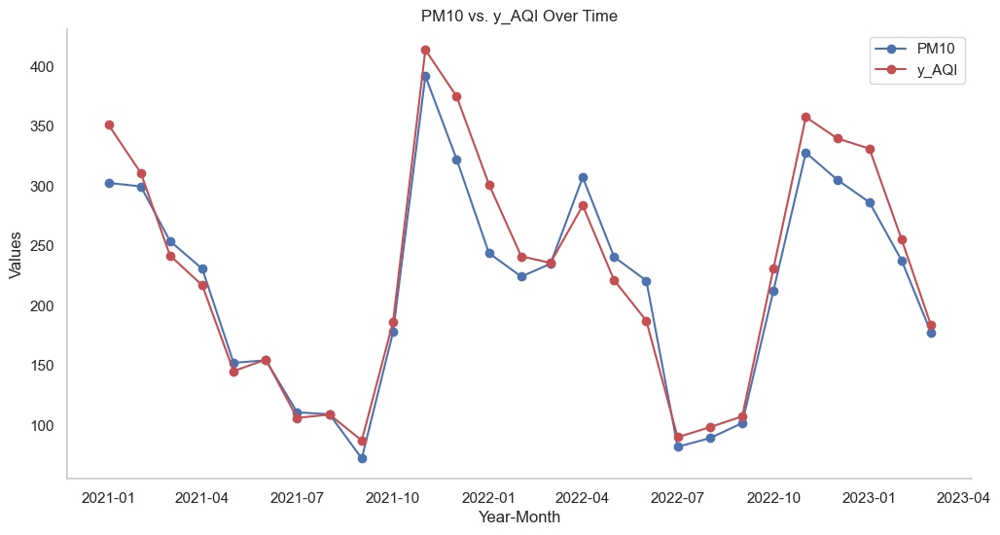

In [56]:
# Convert 'YearMonth' to datetime format
chart_df['YearMonth'] = pd.to_datetime(chart_df['YearMonth'])

# Group by 'YearMonth' and calculate mean PM10 and y_AQI
pm10_aqi_mean = chart_df.groupby('YearMonth')[['PM10 (ug/m3)', 'y_AQI']].mean().reset_index()

# Create a line chart for the relationship between PM10 and y_AQI
plt.figure(figsize=(12, 6))
plt.plot(pm10_aqi_mean['YearMonth'], pm10_aqi_mean['PM10 (ug/m3)'], marker='o', linestyle='-', color='b', label='PM10')
plt.plot(pm10_aqi_mean['YearMonth'], pm10_aqi_mean['y_AQI'], marker='o', linestyle='-', color='r', label='y_AQI')

# Customize the plot
plt.title('PM10 vs. y_AQI Over Time')
plt.xlabel('Year-Month')
plt.ylabel('Values')
plt.legend()
plt.grid(True)

# Remove top right frame
sns.despine(top=True, right=True)

# Remove grid lines
plt.grid(False)

plt.show()

In [60]:
# Hypothesis test for correlation
correlation_coefficient, p_value = stats.pearsonr(chart_df['PM10 (ug/m3)'], chart_df['y_AQI'])

print(f"Correlation Coefficient: {correlation_coefficient:.4f}")
print(f"P-value: {p_value:.4e}")

Correlation Coefficient: 0.7702
P-value: 0.0000e+00


**Conclusion:**

- A very small p-value (0.0), below the commonly used threshold of 0.05, provides robust evidence to reject the null hypothesis, indicating a significant correlation between 'PM10 (ug/m3)' and 'y_AQI'.

- The correlation coefficient of 0.7702 denotes a strong positive correlation. Higher 'PM10 (ug/m3)' values are associated with higher 'y_AQI' values.

- The statistical significance of the p-value (0.0) reinforces that the observed correlation is highly improbable by chance, emphasizing the meaningful relationship between 'PM10 (ug/m3)' and 'y_AQI'.

### Visualization: Scatter Plot with Regression Line for 'PM10 (ug/m3)' vs. 'y_AQI'

**Objective:** Visualize the linear correlation between 'PM10 (ug/m3)' and 'y_AQI'

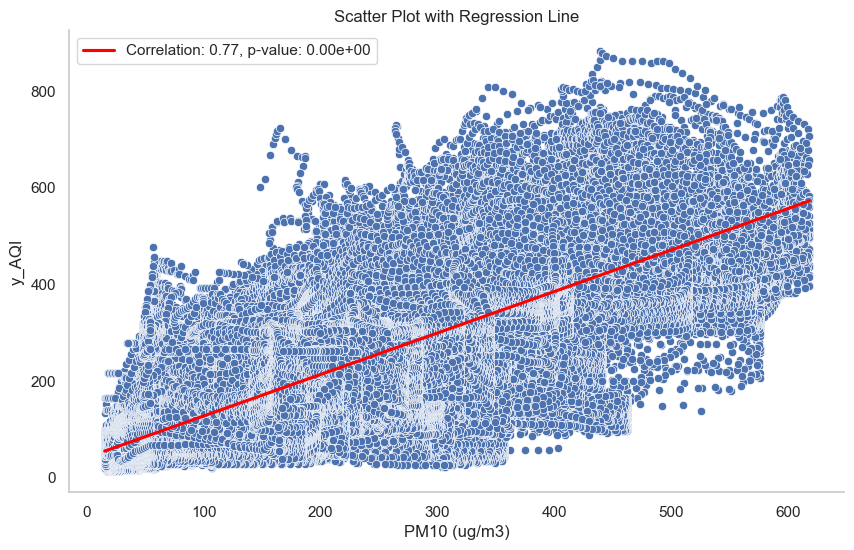

In [62]:
# Scatter plot
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PM10 (ug/m3)', y='y_AQI', data=chart_df)

# Plotting the regression line
sns.regplot(x='PM10 (ug/m3)', y='y_AQI', data=chart_df, scatter=False, color='red', label=f'Correlation: {correlation_coefficient:.2f}, p-value: {p_value:.2e}')

# Customize the plot
plt.title('Scatter Plot with Regression Line')
plt.xlabel('PM10 (ug/m3)')
plt.ylabel('y_AQI')
plt.legend()

# Remove top right frame
sns.despine(top=True, right=True)

# Remove grid lines
plt.grid(False)

plt.show()

**Factors Contributing to the Strong Correlation Between NO2 and y_AQI:**

1. **Shared Emission Sources:** NO2, emitted from combustion in vehicles and industries, may share sources with other pollutants affecting y_AQI.

2. **Chemical Interactions:** NO2 undergoes atmospheric reactions, forming secondary pollutants that contribute to overall air quality and impact the y_AQI.

3. **Meteorological Influences:** NO2 levels are affected by temperature, wind speed, and atmospheric stability, influencing the forecasted y_AQI.

4. **Consistent Spatial and Temporal Patterns:** Similar distribution patterns of NO2 and other pollutants influencing y_AQI contribute to the observed strong correlation.

**Hypothesis Test: NO2 and y_AQI**

**Null Hypothesis (H0):** There is no significant correlation between NO2 levels and the forecasted y_AQI.

**Alternative Hypothesis (H1):** There is a significant correlation between NO2 levels and the forecasted y_AQI.

**Test Statistic:**

In [63]:
# Hypothesis Test
correlation_coefficient, p_value = stats.pearsonr(chart_df['NO2 (ug/m3)'], chart_df['y_AQI'])
print(f"Correlation Coefficient: {correlation_coefficient:.4f}")
print(f"P-value: {p_value:.4e}")


Correlation Coefficient: 0.7289
P-value: 0.0000e+00


**Conclusion:**

- A very small p-value (0.0), below the commonly used threshold of 0.05, provides robust evidence to reject the null hypothesis, indicating a significant correlation between 'NO2 (ug/m3)' and 'y_AQI'.

- The correlation coefficient of 0.7289 denotes a strong positive correlation. Higher 'NO2 (ug/m3)' values are associated with higher 'y_AQI' values.

- The statistical significance of the p-value (0.0) reinforces that the observed correlation is highly improbable by chance, emphasizing the meaningful relationship between 'NO2 (ug/m3)' and 'y_AQI'.

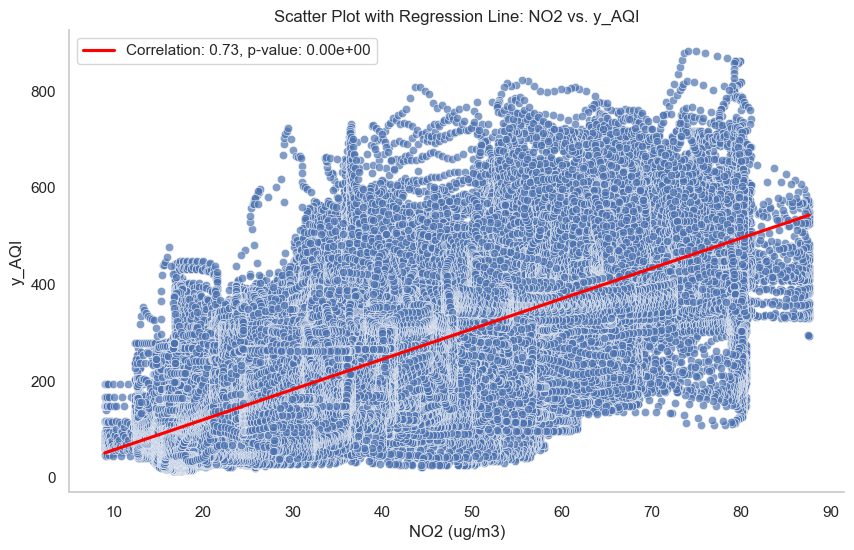

In [65]:
# Scatter plot with Regression Line
plt.figure(figsize=(10, 6))
sns.scatterplot(x='NO2 (ug/m3)', y='y_AQI', data=chart_df, alpha=0.7)

# Plotting the regression line
sns.regplot(x='NO2 (ug/m3)', y='y_AQI', data=chart_df, scatter=False, color='red', label=f'Correlation: {correlation_coefficient:.2f}, p-value: {p_value:.2e}')

# Customize the plot
plt.title('Scatter Plot with Regression Line: NO2 vs. y_AQI')
plt.xlabel('NO2 (ug/m3)')
plt.ylabel('y_AQI')
plt.legend()

# Remove top right frame
sns.despine(top=True, right=True)

# Remove grid lines
plt.grid(False)

plt.show()

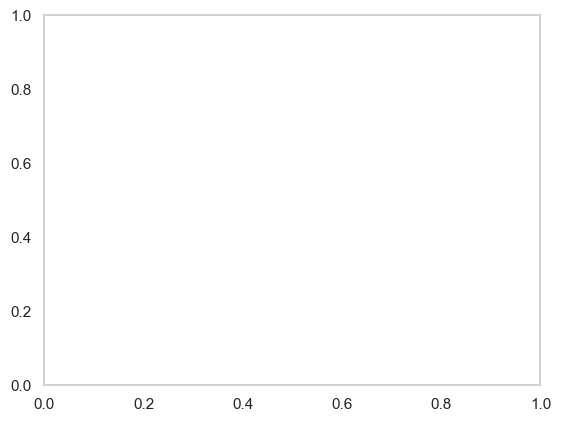

In [53]:

# Convert 'YearMonth' to datetime format
chart_df['YearMonth'] = pd.to_datetime(chart_df['YearMonth'])

# Line plot for 'RH' (Relative Humidity) vs. y_AQI with 'YearMonth' as x-axis
fig = px.line(chart_df, x='YearMonth', y='RH (%)', title='Relative Humidity vs. y_AQI',
              labels={'YearMonth': 'Year-Month', 'RH (%)': 'Relative Humidity (%)'})

# Add scatter points for better visibility
fig.update_traces(mode='markers+lines', marker=dict(size=8, color='blue', line=dict(width=2, color='black')))

# Style the layout for better readability
fig.update_layout(
    xaxis_title='Year-Month',
    yaxis_title='Relative Humidity (%)',
    legend_title='Legend',
    font=dict(family='Arial', size=12, color='black'),
    template='plotly_white',  # White background for better contrast
    hovermode='x',  # Show data on hover
    showlegend=True
)

# Customize line and marker colors and styles
fig.update_traces(line=dict(color='blue', width=2), marker=dict(color='red', size=8, line=dict(color='black', width=2)))

# Remove top right frame
sns.despine(top=True, right=True)

# Remove grid lines
plt.grid(False)

fig.show()

explore the relationship between the hour of the day and y_AQI

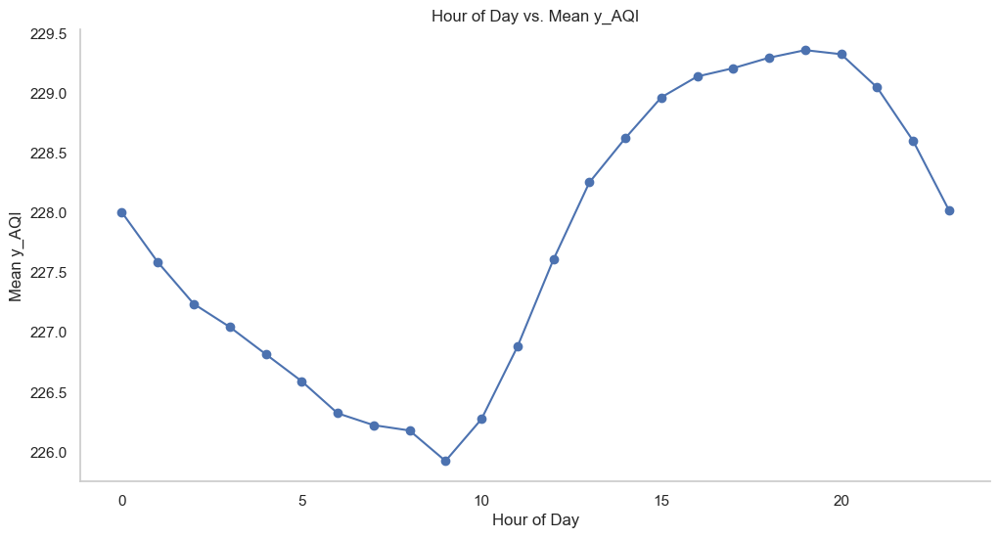

In [90]:
# Convert 'YearMonth' and 'HourOfDay' to datetime format
chart_df['YearMonth'] = pd.to_datetime(chart_df['YearMonth'])
chart_df['HourOfDay'] = chart_df['HourOfDay'].astype(int)

# Group by 'HourOfDay' and calculate mean y_AQI
hourly_mean_aqi = chart_df.groupby('HourOfDay')['y_AQI'].mean().reset_index()

# Create a line chart for the relationship between HourOfDay and y_AQI
plt.figure(figsize=(12, 6))
plt.plot(hourly_mean_aqi['HourOfDay'], hourly_mean_aqi['y_AQI'], marker='o', linestyle='-', color='b')

# Customize the plot
plt.title('Hour of Day vs. Mean y_AQI')
plt.xlabel('Hour of Day')
plt.ylabel('Mean y_AQI')
plt.grid(True)

# Remove top right frame
sns.despine(top=True, right=True)

# Remove grid lines
plt.grid(False)

plt.show()

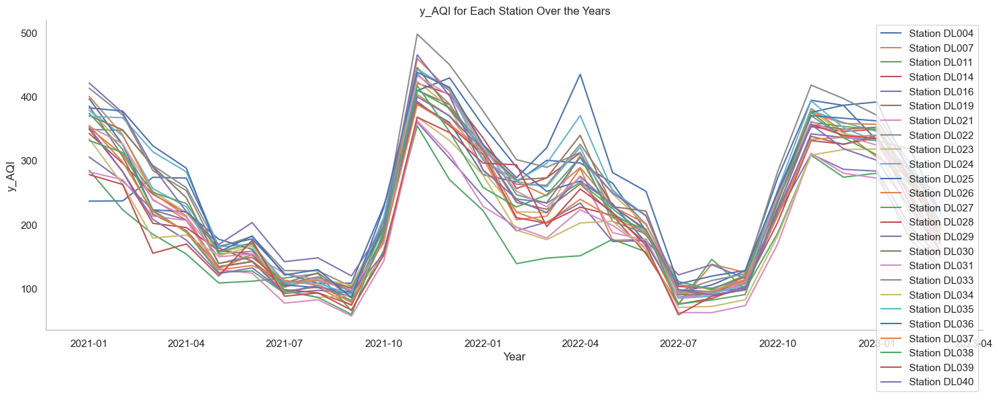

In [55]:
# Group by 'StationId' and 'Year', calculate mean y_AQI
station_level_chart_df = chart_df.groupby(['StationId', 'YearMonth'])['y_AQI'].mean().reset_index()

# Create a line chart for each StationId
plt.figure(figsize=(18, 6))

# Plot y_AQI for each station over the years
for station_id in station_level_chart_df['StationId'].unique():
    station_data = station_level_chart_df[station_level_chart_df['StationId'] == station_id]
    plt.plot(station_data['YearMonth'], station_data['y_AQI'], label=f'Station {station_id}')

# Customize the plot
plt.title('y_AQI for Each Station Over the Years')
plt.xlabel('Year')
plt.ylabel('y_AQI')
plt.legend()
plt.grid(True)

# Remove top right frame
sns.despine(top=True, right=True)

# Remove grid lines
plt.grid(False)

plt.show()

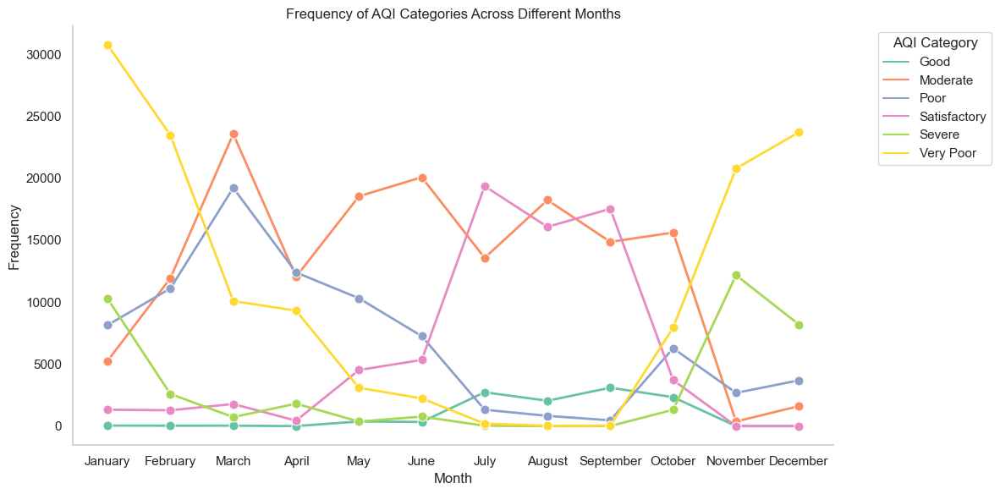

In [179]:
# Map numeric values to month names
df['Month'] = df['Month'].apply(lambda x: calendar.month_name[int(x)])

# Define the order of months
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']

# Convert 'Month' to categorical with specified order
df['Month'] = pd.Categorical(df['Month'], categories=month_order, ordered=True)

# Create a DataFrame with counts
df_counts = df.groupby(['Month', 'AQI_Category']).size().reset_index(name='Count')

# Line Plot: Frequency of AQI categories across different months
plt.figure(figsize=(12, 6))
sns.lineplot(x='Month', y='Count', hue='AQI_Category', data=df_counts, palette='Set2', marker='o', markersize=8, linewidth=2)
plt.title('Frequency of AQI Categories Across Different Months')
plt.xlabel('Month')
plt.ylabel('Frequency')
plt.legend(title='AQI Category', bbox_to_anchor=(1.05, 1), loc='upper left')  # Move legend outside the plot

# Remove the top and right spines
sns.despine()

# Turn off the grid
plt.grid(False)

plt.tight_layout()
plt.show()

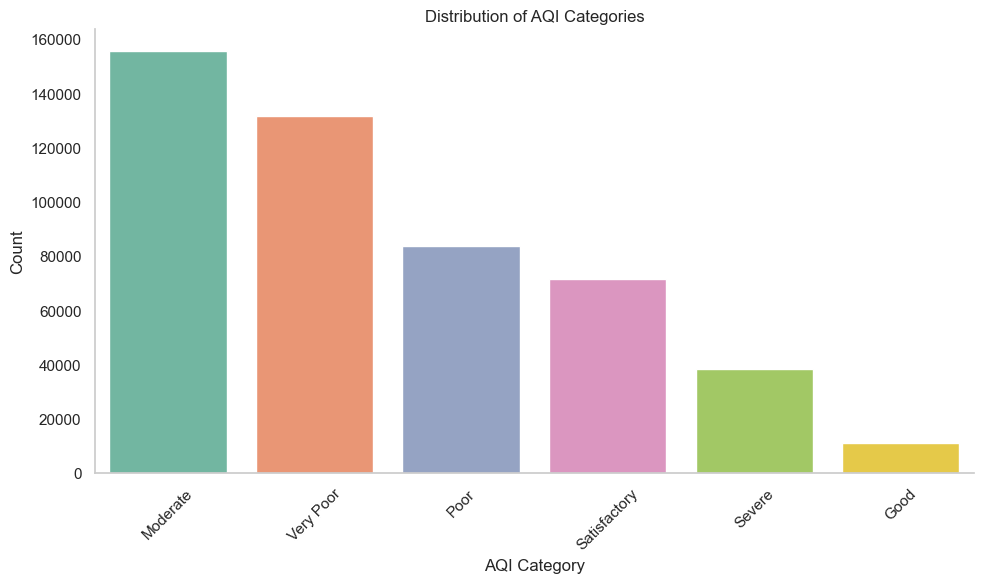

In [163]:
# Count the occurrences of each AQI category
category_counts = df['AQI_Category'].value_counts()

# Bar Plot: Distribution of AQI categories
plt.figure(figsize=(10, 6))
sns.barplot(x=category_counts.index, y=category_counts.values, palette='Set2')
plt.title('Distribution of AQI Categories')
plt.xlabel('AQI Category')
plt.ylabel('Count')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Remove the top and right spines
sns.despine()

# Turn off the grid
plt.grid(False)

plt.tight_layout()
plt.show()

In [172]:
chart_df['DayOfWeek'].dtype

dtype('O')

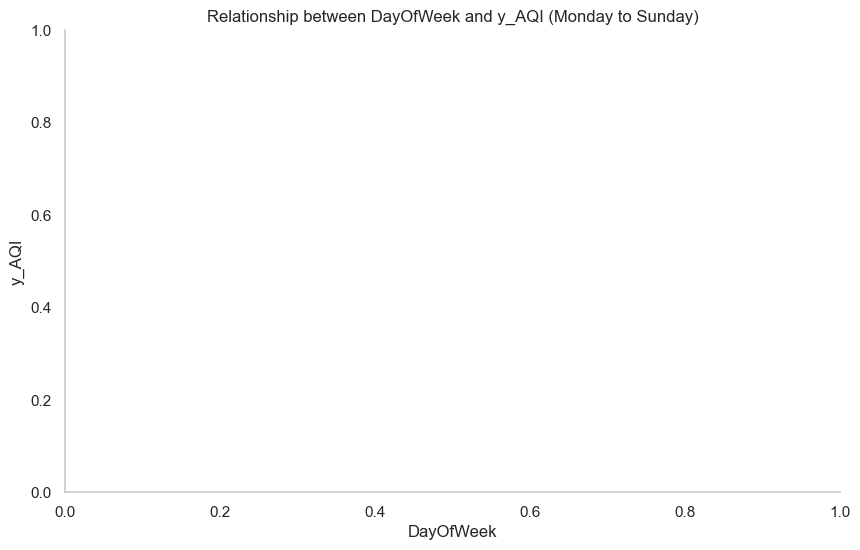

In [91]:
# Set the order of days starting from Monday to Sunday
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Convert 'DayOfWeek' to categorical with the specified order
chart_df['DayOfWeek'] = pd.Categorical(chart_df['DayOfWeek'], categories=day_order, ordered=True)

# Filter for Monday to Sunday
filtered_chart_df = chart_df[chart_df['DayOfWeek'].isin(day_order)]

# Set the style of seaborn for better aesthetics
sns.set(style="whitegrid")

# Line Plot: Relationship between "DayOfWeek" and "y_AQI"
plt.figure(figsize=(10, 6))
sns.lineplot(x='DayOfWeek', y='y_AQI', data=filtered_chart_df, marker='o', color='blue', errorbar=None)

# Remove spines
sns.despine()

# Remove grids
plt.grid(False)

plt.title('Relationship between DayOfWeek and y_AQI (Monday to Sunday)')
plt.xlabel('DayOfWeek')
plt.ylabel('y_AQI')
plt.show()

## Feature Importance using Extra Trees Regressor

This code demonstrates the process of extracting feature importance using the Extra Trees Regressor, a tree-based ensemble learning algorithm. Feature importance helps us understand which features contribute the most to the predictive performance of a machine learning model.

### Steps:

1. **Data Preparation:**
   - Load your dataset into the 'chart_df' DataFrame, assuming it contains relevant features and a target variable ('y_AQI').
   - Separate the features ('X') and the target variable ('y').
2. **Initialize Extra Trees Regressor:**
   - Create an instance of the Extra Trees Regressor with hyperparameters like the number of estimators (trees) and a random seed.

3. **Fit the Model:**
   - Train the Extra Trees Regressor on the training data ('X_train', 'y_train').

4. **Extract Feature Importances:**
   - Retrieve the feature importances from the trained model.

5. **Create Feature Importance DataFrame:**
   - Build a DataFrame containing feature names and their corresponding importance scores.

6. **Sort Features by Importance:**
   - Sort the DataFrame by importance scores in descending order.

7. **Plot Feature Importances:**
   - Visualize feature importances using a bar plot to identify the most influential features.

### Interpretation:

The resulting plot provides insights into which features are most significant for predicting the target variable ('y_AQI'). Features with higher importance scores contribute more to the predictive performance of the Extra Trees Regressor.

Adjust hyperparameters and experiment with different models to optimize feature importance extraction based on your project requirements.

**Note:** Replace 'y_AQI' and other column names with the actual names from your dataset.


In [92]:
import pandas as pd
from sklearn.ensemble import ExtraTreesRegressor
import matplotlib.pyplot as plt

# Assuming 'chart_df' is your DataFrame with features and target
# Replace 'target_column_name' with the actual name of your target column ('y_AQI')

# Separate features and target variable
X = chart_df.drop(columns=['Datetime', 'StationId', 'target_column_name'])
y = chart_df['target_column_name']

# Initialize the Extra Trees Regressor
extra_trees = ExtraTreesRegressor(n_estimators=100, random_state=42)

# Fit the model on the entire dataset
extra_trees.fit(X, y)

# Get feature importances
feature_importances = extra_trees.feature_importances_

# Create a DataFrame with feature names and their importance scores
feature_importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importances})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Plot the feature importances
plt.figure(figsize=(12, 6))
plt.bar(feature_importance_df['Feature'], feature_importance_df['Importance'])
plt.xlabel('Feature')
plt.ylabel('Importance Score')
plt.title('Feature Importance using Extra Trees Regressor')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

KeyError: "['target_column_name'] not found in axis"

In [32]:
# Get all columns except Datetime, StationId and AQI
X_columns = df.drop(['Datetime', 'StationId', 'y_AQI'], axis=1).columns.tolist()
X = df[X_columns]
y = df['y_AQI']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [33]:
# # Set your specific Datetime threshold
# datetime_threshold = pd.to_datetime('2023-01-01')

# # Select records based on your criteria
# train_data = df[df['Datetime'] < datetime_threshold]
# test_data = df[df['Datetime'] >= datetime_threshold]

# # Separate features (X) and target variable (y) for train and test data
# X_train = train_data[X_columns]
# y_train = train_data['y_AQI']
# X_test = test_data[X_columns]
# y_test = test_data['y_AQI']